# MultiCamFallDataset: Optical Flow Dataloaders and EDA Optical Flows
The following jupyter notebook contains research on the following:
1. Dataloaders for CNNs (per frame) or in series (for RNNs or LSTMs).
2. Optical flow EDA analysis across all different chutes (same camera)
3. Optical flow EDA Analysis across all cameras in one chute.

In [1]:
import pandas as pd
import numpy as np
import os
import torch
import matplotlib.pyplot as plt
import seaborn as sns
import cv2
import utils
from tqdm import tqdm

In [2]:
# See of Data path exists
RAW_DATA_PATH = os.path.join(os.getcwd(), os.pardir, "data", "MultiCamFall")
print(os.path.exists(RAW_DATA_PATH))

VIDEO_PATH = os.path.join(RAW_DATA_PATH, "dataset", "dataset")
print(os.path.exists(VIDEO_PATH))\

OF_DATA_PATH = os.path.join(os.getcwd(), "images")
print(os.path.exists(OF_DATA_PATH))

True
True
True


In [3]:
#lets obtain the metadata file
df_metadata = pd.read_csv(os.path.join(RAW_DATA_PATH, "data_tuple3.csv"))
df_metadata.loc[df_metadata["cam"] == 55, "cam"] = 3.0

In [4]:
# Get the device if cuda or not
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

### 1. Lets test if the Frame dataloader is ready for use.

In [5]:
#Create datasets and dataloaders
test_dataset = utils.FigDatasetFrame(data_path=OF_DATA_PATH,\
    dataframe=df_metadata, device=device)

In [6]:
### Obtain an image and labels
img, of_img, labels = test_dataset[45]
print(img.shape)
print(of_img.shape)
print(labels.shape)

torch.Size([224, 224, 3])
torch.Size([224, 224, 3])
torch.Size([1])


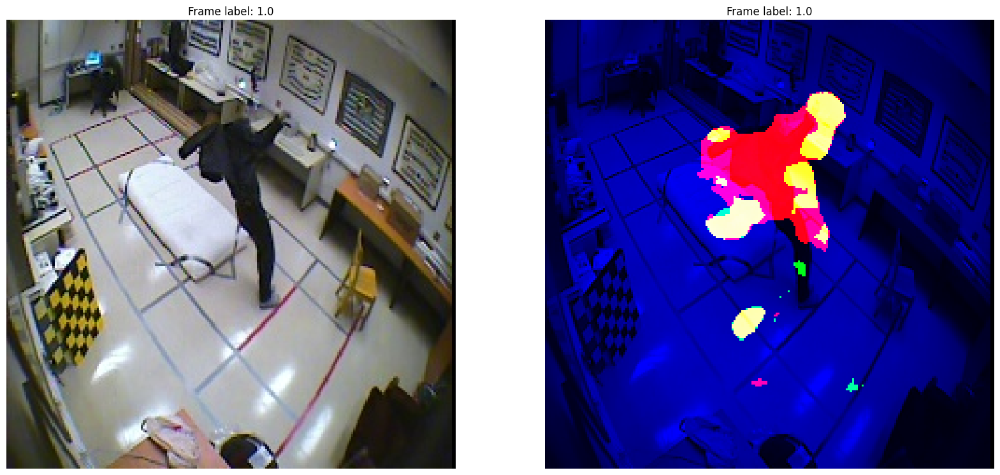

In [7]:
plt.figure(figsize=(20, 20))
plt.subplot(1, 2, 1)
plt.imshow(img.cpu().numpy().astype(np.uint8))
plt.axis("off")
plt.title(f"Frame label: {labels.item()}")
plt.subplot(1, 2, 2)
plt.imshow(of_img.cpu().numpy().astype(np.uint8))
plt.axis("off")
plt.title(f"Frame label: {labels.item()}")
plt.show()

### 2. Use the Series dataloader in order to see if its ready for usage.

In [8]:
#Create datasets and dataloaders
test_dataset = utils.FigDatasetSeries(data_path=OF_DATA_PATH,\
    dataframe=df_metadata, device=device)


### Obtain a specific series based on index
Lets do one for fall and one for no fall

In [9]:
# Based on the head, lets select index 0 and 1 for testing
df_metadata.head(10)

#This is for later plotting
df_subset = df_metadata[df_metadata["chute"] == 1]
print(df_subset.head(3))

#Find the index inside df_metadata where it equals to the 1st row in df_subset
index = df_metadata.index[df_metadata["cam"] == 2.0][0]

print(index)

   chute  cam   start     end  label
0    1.0  1.0  1052.0  1082.0    0.0
1    1.0  1.0  1083.0  1113.0    1.0
2    1.0  1.0  1114.0  1144.0    0.0
3


In [10]:
#Lets select it
pre_fall_series_imgs,pre_fall_series_ofs, pre_fall_labels = test_dataset[0]
fall_series_imgs, fall_series_ofs, fall_labels= test_dataset[1]
post_fall_series_imgs, post_fall_series_ofs, post_fall_labels = test_dataset[2]

In [11]:
# Print tne shape of one of the series of data
print(pre_fall_series_ofs.shape)
print(pre_fall_labels.shape)

torch.Size([30, 224, 224, 3])
torch.Size([30])


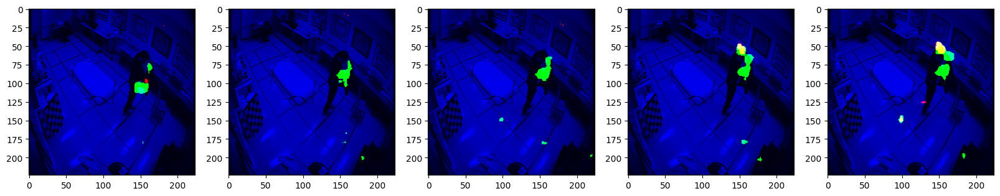

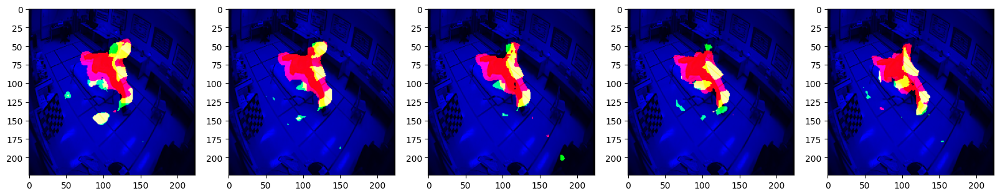

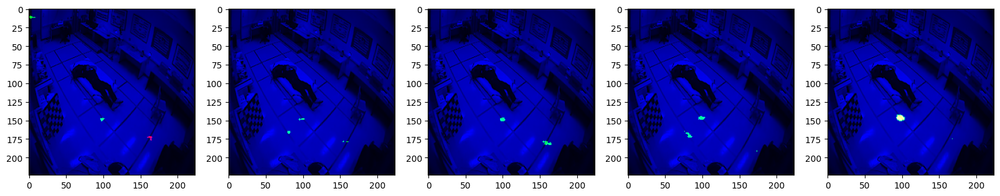

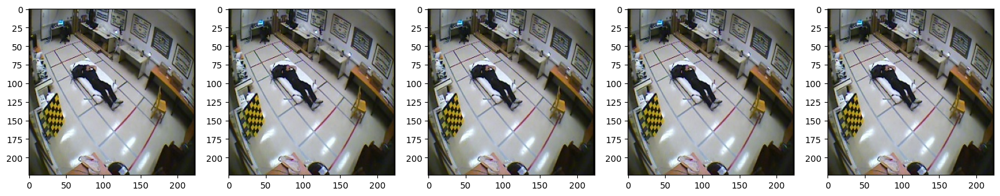

In [12]:
# Have a plot idx of the data retrieved
plot_idx = 17
plot_range = np.arange(plot_idx, plot_idx + 5)

plt.figure(figsize = (20, 10))
for plot_idx in plot_range:
    plt.subplot(1, 5, plot_idx - plot_range[0] + 1)
    plt.imshow(pre_fall_series_ofs[plot_idx].cpu().numpy().astype(np.uint8))

plt.figure(figsize = (20, 10))
for plot_idx in plot_range:
    plt.subplot(1, 5, plot_idx - plot_range[0] + 1)
    plt.imshow(fall_series_ofs[plot_idx].cpu().numpy().astype(np.uint8))

plt.figure(figsize = (20, 10))
for plot_idx in plot_range:
    plt.subplot(1, 5, plot_idx - plot_range[0] + 1)
    plt.imshow(post_fall_series_ofs[plot_idx].cpu().numpy().astype(np.uint8))

plt.figure(figsize = (20, 10))
for plot_idx in plot_range:
    plt.subplot(1, 5, plot_idx - plot_range[0] + 1)
    plt.imshow(post_fall_series_imgs[plot_idx].cpu().numpy().astype(np.uint8))

## For Chute 1, Scenario 1.

Its pretty visible between frames the following events:
1. Pre fall events (label = 0) have OFs where showcase slight movement.
2. Falling events (label = 1) have OFs where showcase more movement, indicating a fall.
3. A post fall event (Labe; = 0) have OFs where showcase no more movement, indicating the post of a fall.

This is interesting since when only a fall environment occurs, there is a lot of activity of OFs around to indicate the masking of a fall.
**NOW HERE IS THE THING**. We need to see a scenario where there are multiple activities going on.

For different chutes, there were other activities. Thankfully, the dataframe where we got the frames from does concord with the technical report of the data; where fall events occur or not. That being said. Its trully important that we see at least an example of each Chute to see how the data behaves for different chutes.

# Plotting of different chutes


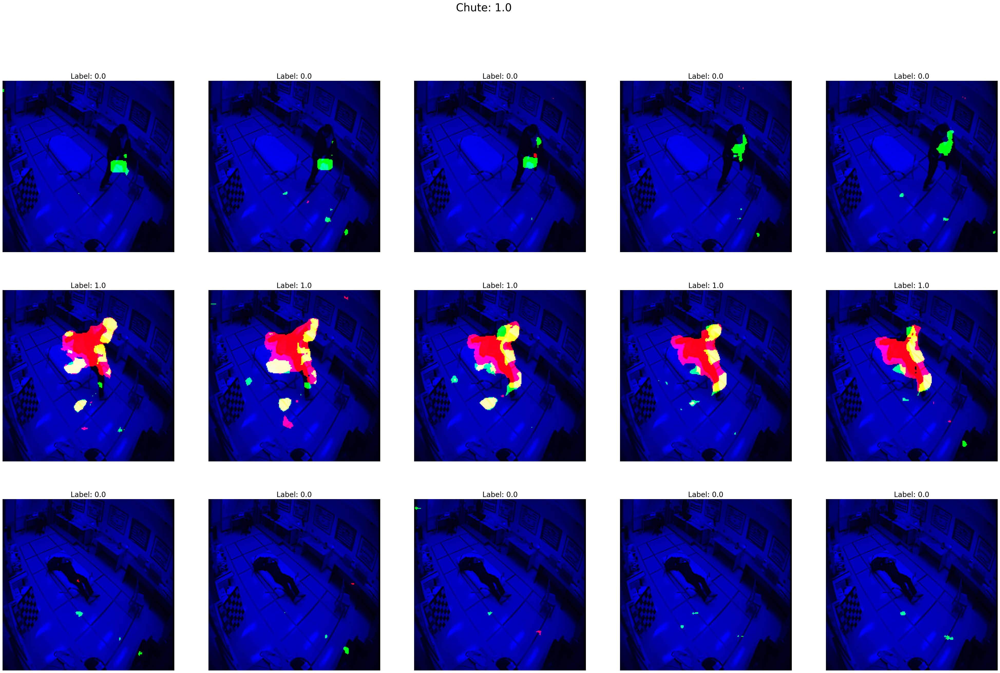

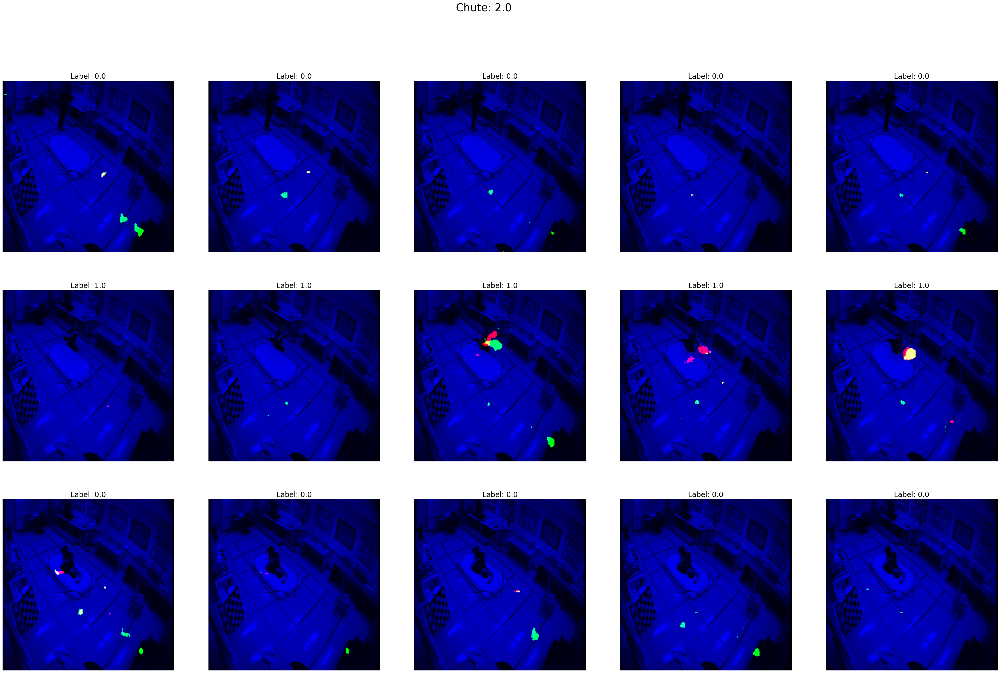

In [13]:
#Set the range of chutes where you get the data from.
chute_range = df_metadata["chute"].unique()[0:2]

#Set frame idx to plot
frame_idx = 15
for chute_idx in chute_range:

    #Hold a list for indices to get data from test_dataset
    plot_indices = []

    #Select only the first three rows
    for event_idx in range(3):
        #Find the index inside df_metadata where it equals to the 1st row in df_subset
        index = df_metadata.index[df_metadata["chute"] == chute_idx][event_idx]
        plot_indices.append(index)
    
    # Now, lets select the data we want to plot.
    __, pre_fall_series_ofs, pre_fall_labels = test_dataset[plot_indices[0]]
    __, fall_series_ofs, fall_labels= test_dataset[plot_indices[1]]
    __, post_fall_series_ofs, post_fall_labels = test_dataset[plot_indices[2]]

    # Have a plot idx of the data retrieved
    plot_range = np.arange(frame_idx, frame_idx + 5)

    plt.figure(figsize = (50, 30))
    plt.suptitle(f"Chute: {chute_idx}", fontsize = 30)
    for plot_idx in plot_range:
        plt.subplot(3, 5, plot_idx - plot_range[0] + 1)
        plt.imshow(pre_fall_series_ofs[plot_idx].cpu().numpy().astype(np.uint8))
        plt.title(f"Label: {pre_fall_labels[plot_idx].item()}", fontsize=20)
        plt.axis("off")
        plt.subplot(3, 5, plot_idx - plot_range[0] + 6)
        plt.imshow(fall_series_ofs[plot_idx].cpu().numpy().astype(np.uint8))
        plt.title(f"Label: {fall_labels[plot_idx].item()}", fontsize = 20)
        plt.axis("off")
        plt.subplot(3, 5, plot_idx - plot_range[0] + 11)
        plt.imshow(post_fall_series_ofs[plot_idx].cpu().numpy().astype(np.uint8))
        plt.title(f"Label: {post_fall_labels[plot_idx].item()}", fontsize = 20)
        plt.axis("off")
    plt.show()

### Findings:

This is interesting! It showcases the following:
1. Across all chutes, Using Camera 1 only: It appears that OF flows were calculated once there was a certain distance in the image.
2. For some, its pretty clear the masking was really good to obtain flows across frames.
3. For others it was really visible!

This showcases that the masking method of OFs has its limitations, specially when the person is so far away from the camera that it doesnt detects it. Nevertherless, there is still the gray channel that contains information; so hopefully the CNN model would be able to tell.

# Plotting all Cameras in One Chute
It should be done the following:
1. Load one chute only.
2. See all frames, for all different 8 cameras, (30 * 8 = 240 frames).
3. See how each camera behaves! We want a majority of cameras with proper OF flows > Cameras without proper OF flaws and labelling.

In [14]:
print(df_metadata["cam"].unique())
df_metadata.head(12)

[1. 2. 3. 4. 5. 6. 7. 8.]


,chute,cam,start,end,label
0,1.0,1.0,1052.0,1082.0,0.0
1,1.0,1.0,1083.0,1113.0,1.0
2,1.0,1.0,1114.0,1144.0,0.0
3,1.0,2.0,1052.0,1082.0,0.0
4,1.0,2.0,1083.0,1113.0,1.0
5,1.0,2.0,1114.0,1144.0,0.0
6,1.0,3.0,1057.0,1087.0,0.0
7,1.0,3.0,1088.0,1118.0,1.0
8,1.0,3.0,1119.0,1149.0,0.0
9,1.0,4.0,1053.0,1083.0,0.0


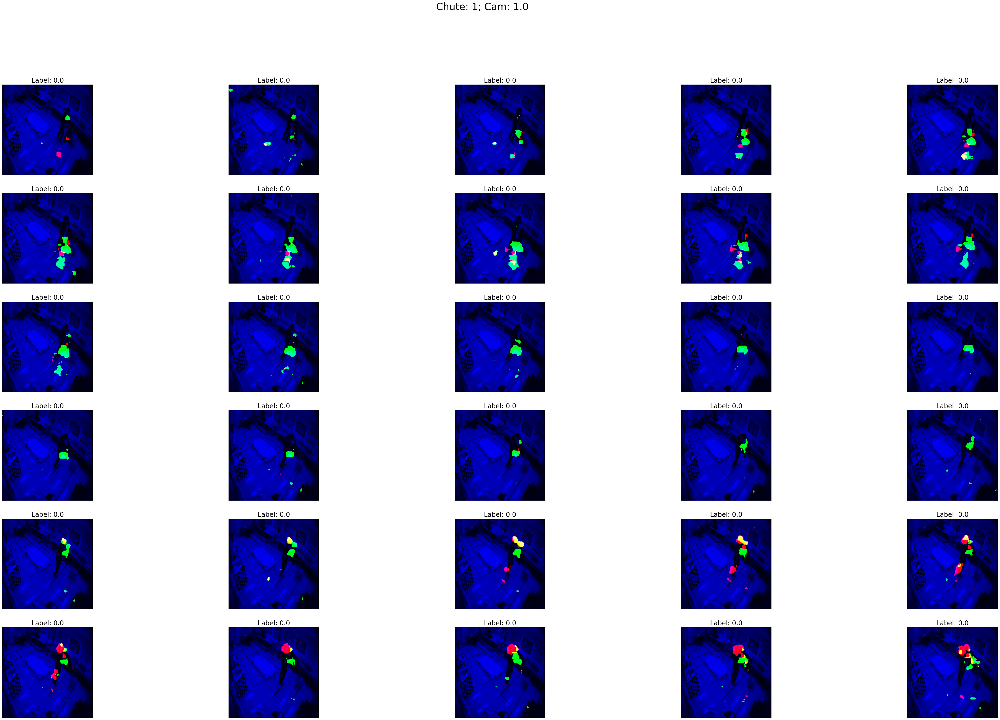

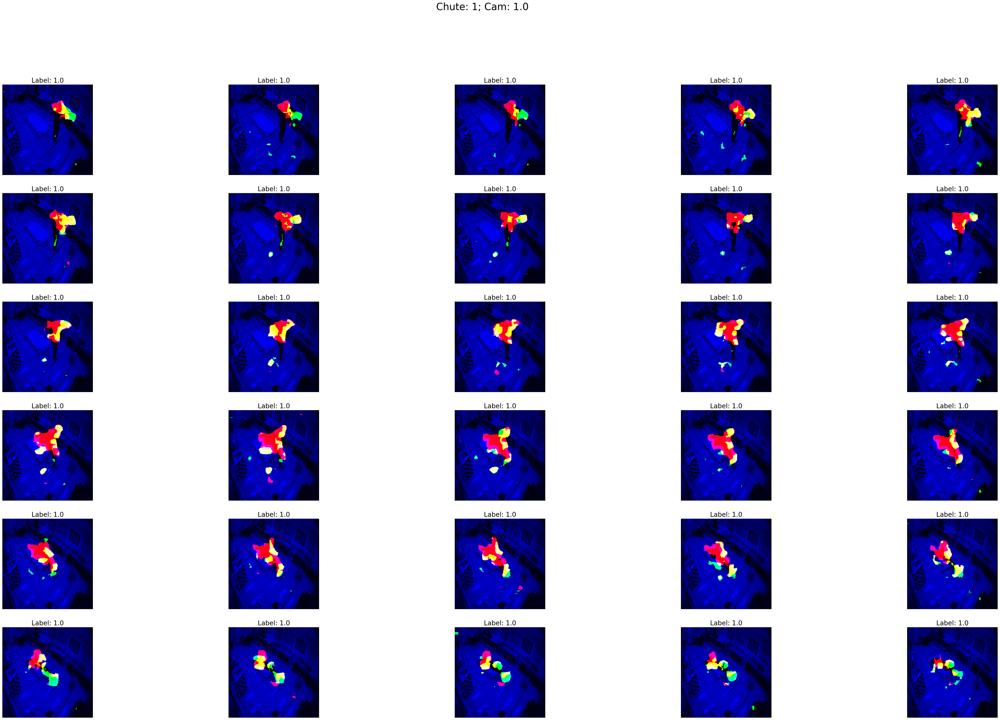

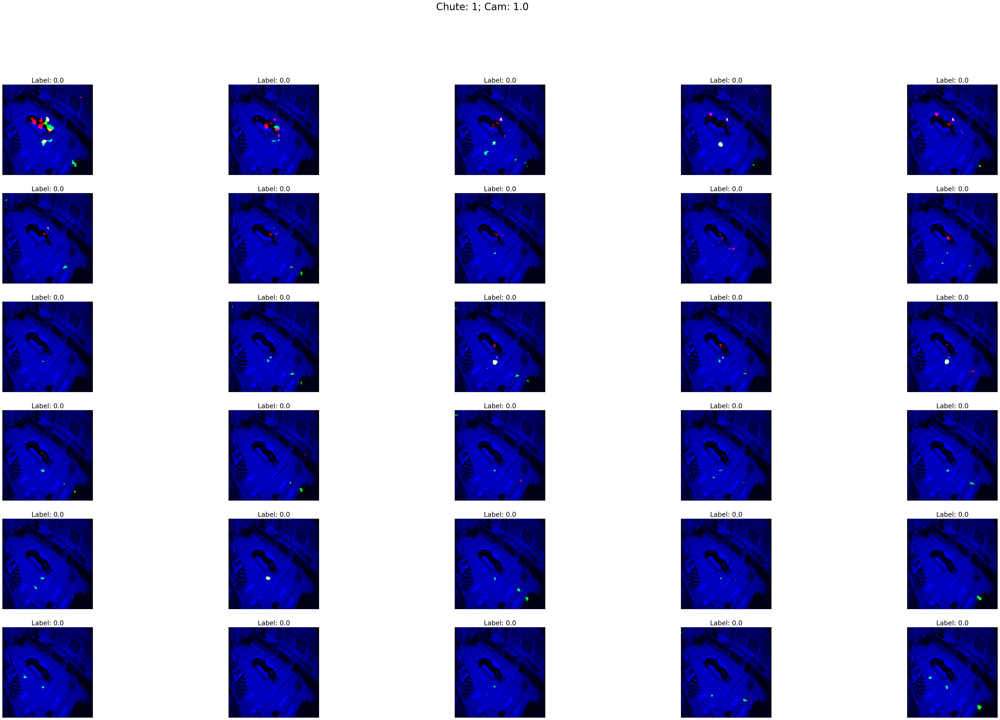

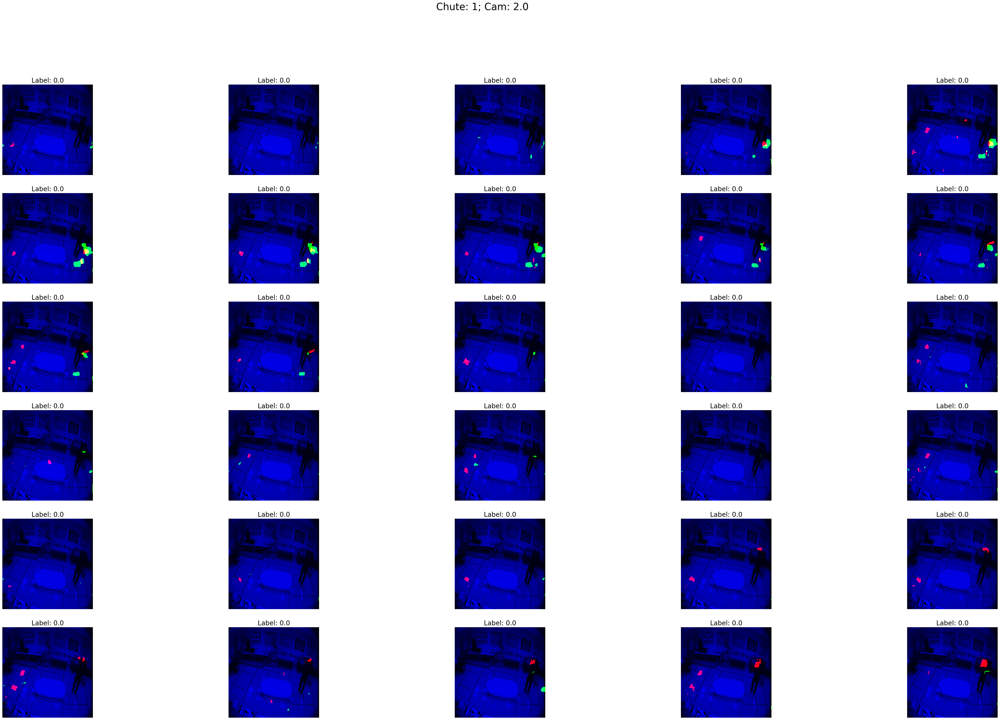

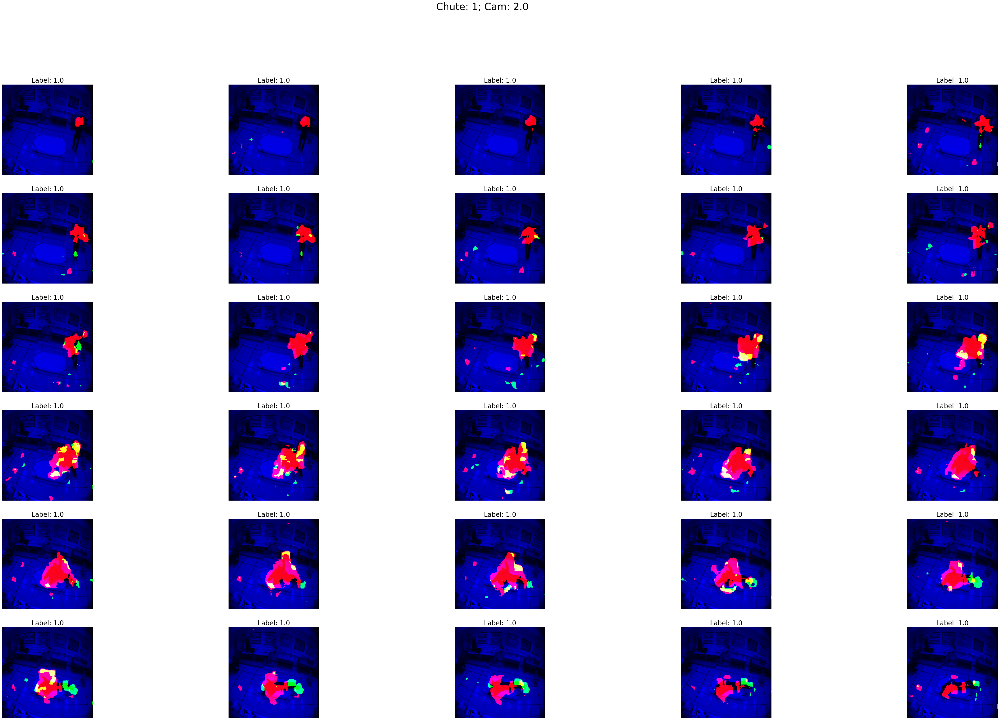

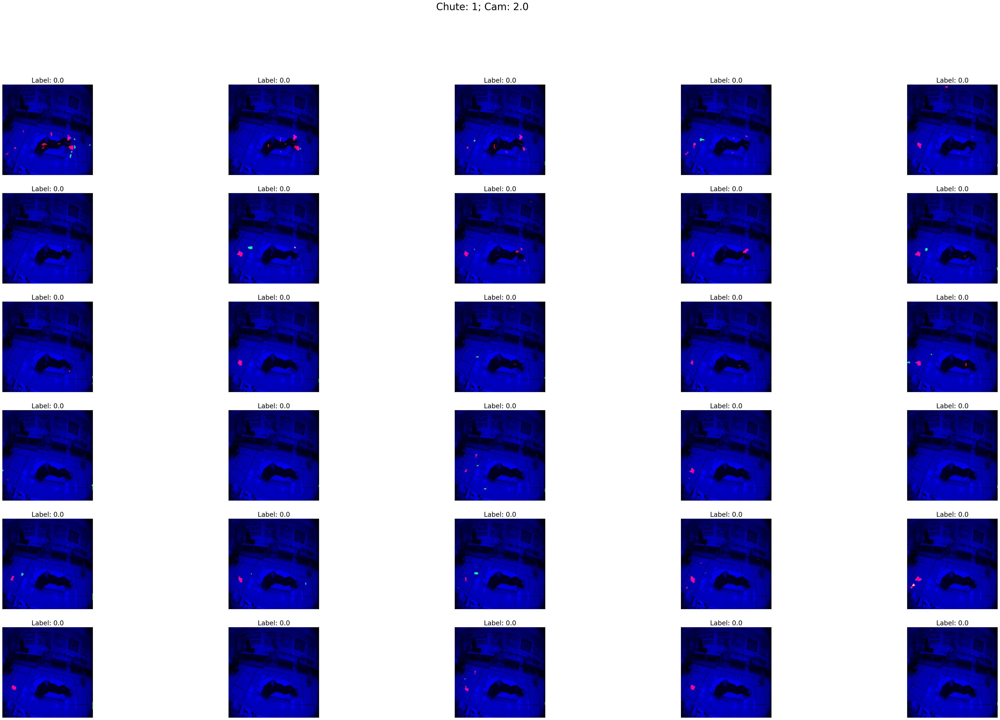

In [15]:
#Lets select a chute specifically
chute_selected = 1

#Lets create a camera range from all cameras
cam_range = df_metadata["cam"].unique()[0:2]

# lets iterate across camera
for cam_idx in cam_range:

    #Obtain the indices for specific cam and chute
    indices = df_metadata.index[(df_metadata["cam"] == cam_idx) & (df_metadata["chute"] == chute_selected)]

    #If length of indices is less than 3, create a list from 0 to len(indices), else, list from 0 to 2.
    if len(indices) < 3:
        event_indices = np.array(indices)[np.arange(0, len(indices))]
    else:
        event_indices = np.array(indices)[np.arange(0, 3)]

    #Select only the first three rows
    for index in event_indices:
    
        # Now, lets select the data we want to plot.
        __, data_series, data_labels = test_dataset[index]

        # Let's create a figure to plot all of the frames
        frame_range = np.arange(0, data_series.shape[0])

        plt.figure(figsize = (60, 35))
        plt.suptitle(f"Chute: {chute_selected}; Cam: {cam_idx}", fontsize = 30)
        for plot_idx in frame_range:
            plt.subplot(6, 5, plot_idx - frame_range[0] + 1)
            plt.imshow(data_series[plot_idx].cpu().numpy().astype(np.uint8))
            plt.title(f"Label: {data_labels[plot_idx].item()}", fontsize=20)
            plt.axis("off")
        plt.show()

### Observations!

Its true! There is indeed optical flow gradients that were not seen by other cameras when:
1. The person was in an angle that hid vertically the place of fall.
2. The person was far away for the OF algorithm to even register the movement between frames
3. The person was doing extra activities (movement, etc), while falling at the same time.

This is key to notice since for future tests; what can be done are the following:
1. Instead of resizing the image to 224x224x2L and calculate OFs, we can first calculate OFs on 480x720x3 images and then resize them to 224x224x2L.
2. Instead of using Farnerback aproach, there could be other hyperparameters we can tune to obtain a better mask of flow.
3. The data, althought controlled, could have had changes of background lighting or the movement was so fast. REMEMBER that the principle of optical flow gradient to be almost as equal as movement is if these two conditions are indeed met. Otherwise, me might need a new different approach to find movement for a better mask.